In [ ]:
import cv2
import os, glob
import numpy as np
import seaborn as sns
from imutils import paths
import matplotlib.pyplot as plt
import sklearn.metrics as metrics
import matplotlib.pyplot as plt
from sklearn.preprocessing import LabelBinarizer
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix, classification_report
from PIL import Image
import pandas as pd
import tensorflow as tf
from tensorflow import keras
from glob import glob
import matplotlib.pyplot as plt
import tensorflow as tf
from keras.applications.resnet50 import ResNet50
from keras.preprocessing import image
import itertools
from tensorflow.keras.models import load_model
from sklearn.model_selection import train_test_split
import ipywidgets as widgets
from ipywidgets import interact, interact_manual
!pip install numpy tensorflow matplotlib pandas scikit-learn opencv-python ipywidgets
from sklearn.metrics import classification_report, confusion_matrix
!pip install tensorflow
import keras
from tensorflow.keras.models import Model
from tensorflow.keras.models import Sequential
from tensorflow.keras.optimizers import Adam,RMSprop
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.applications import VGG16, ResNet101, Xception,VGG19,InceptionResNetV2,ResNet50V2,InceptionV3,MobileNetV2,MobileNet
from tensorflow.keras.layers import Input, Dense, Flatten, AveragePooling2D, Dropout, BatchNormalization, Conv2D, MaxPooling2D,Activation,add

In [ ]:
!pip install opencv-python
!pip install imutils

In [ ]:
from google.colab import drive
drive.mount('/content/drive/',force_remount=True)

Mounted at /content/drive/


In [ ]:
!unzip /content/drive/MyDrive/project/archive.zip

In [ ]:
train_path = '/content/train'
test_path = '/content/test'
valid_path = '/content/val'
random_path = '/content/auto_test'

In [ ]:
import os
import shutil

train_path = '/content/train'
test_path = '/content/test'

# Assuming you have subdirectories 0, 1, 2, 3, 4 in both train and test folders
class_folders = ['0', '1', '2', '3', '4']

for class_folder in class_folders:
    train_class_path = os.path.join(train_path, class_folder)
    test_class_path = os.path.join(test_path, class_folder)

    # Ensure the train folder exists, create it if not
    if not os.path.exists(train_class_path):
        os.makedirs(train_class_path)

    # Copy files from test folder to train folder
    test_files = os.listdir(test_class_path)
    for file in test_files:
        src_path = os.path.join(test_class_path, file)
        dst_path = os.path.join(train_class_path, file)

        # Check if the file already exists in the train folder to avoid overwriting
        if not os.path.exists(dst_path):
            shutil.copy(src_path, dst_path)


In [ ]:
import os
folder_path = '/content/train'
# Get the list of items in the directory
items = os.listdir(folder_path)
# Filter out only folders
folders = [item for item in items if os.path.isdir(os.path.join(folder_path, item))]
# Get the number of folders
num_folders = len(folders)
print(num_folders)

5


In [ ]:
# import os
# path, dirs, filescyst = next(os.walk("D:/Dataset/Mkidney/cyst"))
# path, dirs, filesnormal = next(os.walk("D:/Dataset/Mkidney/Normal"))
# path, dirs, filesstone = next(os.walk("D:/Dataset/Mkidney/Stone"))
# path, dirs, filestumor = next(os.walk("D:/Dataset/Mkidney/Tumor"))

In [ ]:
# Define folder paths
Healthy = '/content/train/0'
Doubtful = '/content/train/1'
Minimal = '/content/train/2'
Moderate = '/content/train/3'
Severe = '/content/train/4'

# Function to count images in a folder
def count_images(folder_path):
    # Get the list of files in the folder
    files = os.listdir(folder_path)

    # Filter out only files with certain extensions (e.g., '.jpg', '.png')
    image_files = [file for file in files if file.endswith(('.jpg', '.png'))]

    # Get the number of image files
    num_images = len(image_files)

    return num_images

# Count images in each folder
num_images_healthy = count_images(Healthy)
num_images_doubtful = count_images(Doubtful)
num_images_minimal = count_images(Minimal)
num_images_moderate = count_images(Moderate)
num_images_severe = count_images(Severe)
# Print the results
print(f"Number of images in Healthy folder: {num_images_healthy}")
print(f"Number of images in Doubtful folder: {num_images_doubtful}")
print(f"Number of images in Minimal folder: {num_images_minimal}")
print(f"Number of images in Moderate folder: {num_images_moderate}")
print(f"Number of images in Severe folder: {num_images_severe}")


Number of images in Healthy folder: 2925
Number of images in Doubtful folder: 1342
Number of images in Minimal folder: 1963
Number of images in Moderate folder: 980
Number of images in Severe folder: 224


In [ ]:
# !rm -rf kneeDataset

In [ ]:
LR = 0.001
EPOCHS = 100
BATCH_SIZE = 75
INP_SIZE = (705,569,3)

In [ ]:
import glob
import cv2

def create_data(dir_name):
    temp_data = []
    img_list = glob.glob(dir_name + '/*')
    print(len(img_list))
    for img in img_list[:]:
        image = cv2.imread(img)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        image = cv2.resize(image, (124, 124))
        temp_data.append(image)
    return temp_data

data = []
labels = []

Healthy_dir = "/content/train/0"
Doubtful_dir = "/content/train/1"
Minimal_dir = "/content/train/2"
Moderate_dir = "/content/train/3"
Severe_dir = "/content/train/4"

In [ ]:
data.extend(create_data(Healthy_dir))

2925


In [ ]:
data.extend(create_data(Doubtful_dir))

1342


In [ ]:
data.extend(create_data(Minimal_dir))

1963


In [ ]:
data.extend(create_data(Moderate_dir))

980


In [ ]:
data.extend(create_data(Severe_dir))

224


In [ ]:
labels=[]
labels.extend([0]*len(create_data(Healthy_dir)))
labels.extend([0]*len(create_data(Doubtful_dir)))
labels.extend([0]*len(create_data(Minimal_dir)))
labels.extend([1]*len(create_data(Moderate_dir)))
labels.extend([2]*len(create_data(Severe_dir)))


2925
1342
1963
980
224


In [ ]:
print(len(labels),len(data))

7434 7434


In [ ]:
data = np.array(data)
labels = np.array(labels)
print(data.shape)
print(labels.shape)

(7434, 124, 124, 3)
(7434,)


In [ ]:
Healthy_sample = glob.glob("/content/train/0/*")[40:44]
Doubtful_sample = glob.glob("/content/train/1/*")[40:44]
Minimal_sample = glob.glob("/content/train/2/*")[40:44]
Moderate_sample = glob.glob("/content/train/3/*")[40:44]
Severe_sample = glob.glob("/content/train/4/*")[40:44]

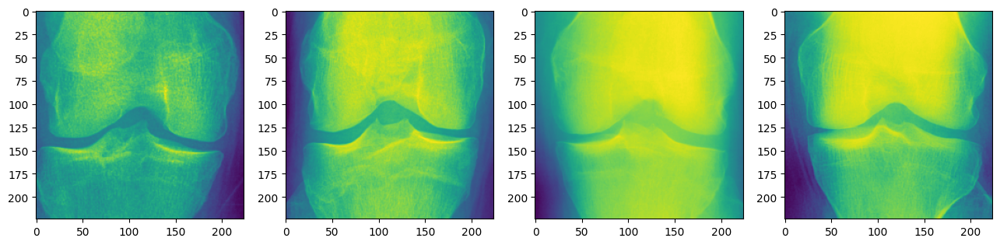

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import numpy as np
import math


plt.figure(figsize=(20, 10))
columns = 5
num_images = len(Healthy_sample)
num_rows = math.ceil(num_images / columns)

for i, image in enumerate(Healthy_sample):
    plt.subplot(num_rows, columns, i + 1)
    plt.imshow(mpimg.imread(image))

plt.show()

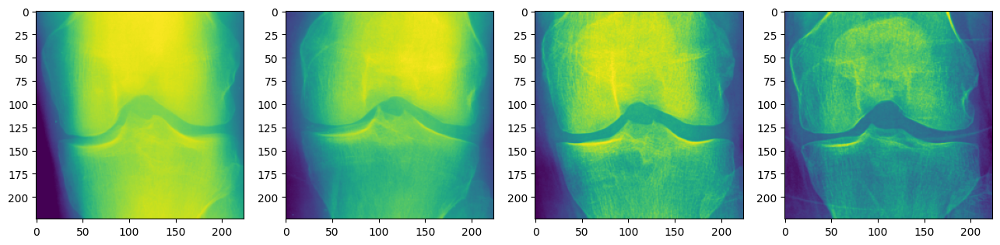

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import numpy as np
import math


plt.figure(figsize=(20, 10))
columns = 5
num_images = len(Doubtful_sample)
num_rows = math.ceil(num_images / columns)

for i, image in enumerate(Doubtful_sample):
    plt.subplot(num_rows, columns, i + 1)
    plt.imshow(mpimg.imread(image))

plt.show()

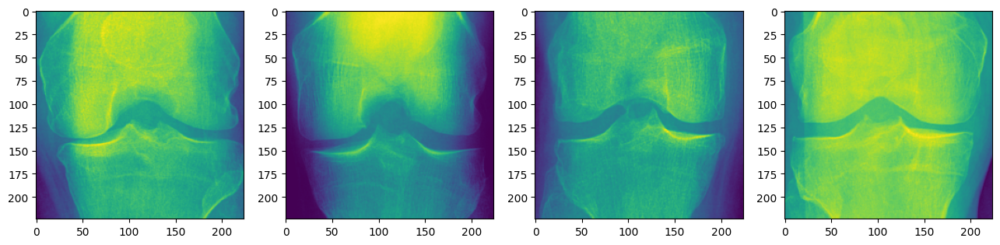

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import numpy as np
import math


plt.figure(figsize=(20, 10))
columns = 5
num_images = len(Minimal_sample)
num_rows = math.ceil(num_images / columns)

for i, image in enumerate(Minimal_sample):
    plt.subplot(num_rows, columns, i + 1)
    plt.imshow(mpimg.imread(image))

plt.show()

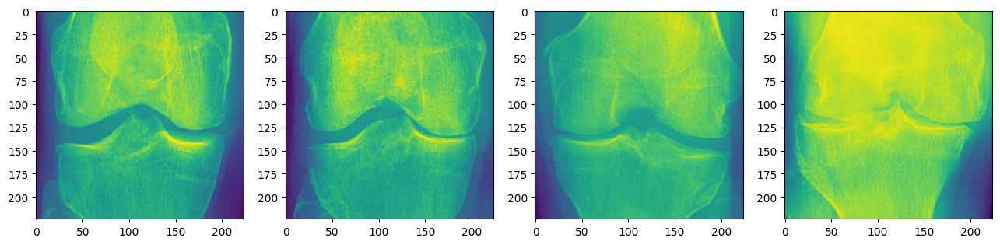

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import numpy as np
import math


plt.figure(figsize=(20, 10))
columns = 5
num_images = len(Moderate_sample)
num_rows = math.ceil(num_images / columns)

for i, image in enumerate(Moderate_sample):
    plt.subplot(num_rows, columns, i + 1)
    plt.imshow(mpimg.imread(image))

plt.show()

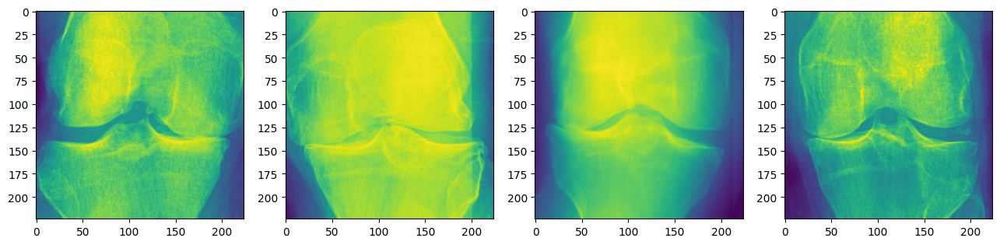

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import numpy as np
import math


plt.figure(figsize=(20, 10))
columns = 5
num_images = len(Severe_sample)
num_rows = math.ceil(num_images / columns)

for i, image in enumerate(Severe_sample):
    plt.subplot(num_rows, columns, i + 1)
    plt.imshow(mpimg.imread(image))

plt.show()

In [ ]:
# from keras.preprocessing.image import ImageDataGenerator

# train_datagen = ImageDataGenerator(rescale=1./255, rotation_range=15, fill_mode='nearest')

# val_datagen = ImageDataGenerator(rescale=1./255)

In [ ]:
# IMG_DIM = (124, 124)
# from keras.preprocessing import image
# samples = glob.glob(tumor_dir + '/*')
# train_imgs = [image.img_to_array(image.load_img(img, target_size=IMG_DIM)) for img in samples]

In [ ]:
# train_labels = ["CANCER" for fn in train_imgs]

In [ ]:
# train_imgs = np.array(train_imgs)

In [ ]:
# img_id = 0
# cat_generator = train_datagen.flow(train_imgs[img_id:img_id+1], train_labels[img_id:img_id+1],batch_size=1)
# cat = [next(cat_generator) for i in range(0,5)]
# fig, ax = plt.subplots(1,5, figsize=(16, 6))
# print('Labels:', [item[1][0] for item in cat])
# l = [ax[i].imshow(cat[i][0][0]) for i in range(0,5)]

In [ ]:
#lb = LabelBinarizer()
#labels = lb.fit_transform(labels)
#labels = to_categorical(labels)
from sklearn.preprocessing import LabelEncoder
lb = LabelEncoder()
labels = lb.fit_transform(labels)
labels = to_categorical(labels)

(x_train, x_test, y_train, y_test) = train_test_split(
    data,
    labels,
    test_size=0.20,
    stratify=labels,
    random_state=42
)
trainAug = ImageDataGenerator(
    rotation_range=15,
    fill_mode="nearest"
)

print(x_train.shape)
print(y_train.shape)
print(x_test.shape)
print(y_test.shape)


(5947, 124, 124, 3)
(5947, 3)
(1487, 124, 124, 3)
(1487, 3)


In [ ]:
def display_history(history_):
    fig, ax = plt.subplots(1,2, figsize=(12, 3))
    ax[0].plot(history_.history['loss'], color='b', label="training_loss")
    ax[0].plot(history_.history['val_loss'], color='r', label="validation_loss",axes =ax[0])
    ax[0].set_xlabel("Epoch")
    ax[0].set_ylabel("Loss")
    legend = ax[0].legend(loc='best', shadow=True)
    ax[1].plot(history_.history['accuracy'], color='b', label="training_accuracy")
    ax[1].plot(history_.history['val_accuracy'], color='r',label="validation_accuracy")
    ax[1].set_xlabel("Epoch")
    ax[1].set_ylabel("Accuracy")
    legend = ax[1].legend(loc='best', shadow=True)

def plot_metrices(model_):
    plt.figure()
    ax = plt.subplot()
    ax.set_title('Confusion Matrix')
    pred = model_.predict(x_test, batch_size = BATCH_SIZE)
    pred = np.argmax(pred, axis = 1)
    cm = confusion_matrix(y_test.argmax(axis = 1), pred)
    classes=['HEALTHY', 'MODERATE', 'SEVERE']
    sns.heatmap(cm, annot = True, xticklabels = classes, yticklabels = classes, cmap = 'Reds')

    plt.xlabel('Predicted')
    plt.ylabel('Actual')
    plt.show

    print(classification_report(y_test.argmax(axis = 1), pred))
    total = sum(sum(cm))
    acc = (cm[0, 0] + cm[1, 1]) / total
    sensitivity = cm[0, 0] / (cm[0, 0] + cm[0, 1])
    specificity = cm[1, 1] / (cm[1, 0] + cm[1, 1])

    print("ACC: {:.4f}".format(acc))
    print("Sensitivity: {:.4f}".format(sensitivity))
    print("Specificity: {:.4f}".format(specificity))


In [ ]:
from keras.layers import GlobalMaxPooling2D


In [ ]:
model = Sequential()
model.add(Conv2D(32, (5, 5), activation='relu', input_shape=(124, 124, 3)))
model.add(Conv2D(32, (5, 5), activation='relu'))
model.add(Conv2D(32, (5, 5), activation='relu'))
model.add(MaxPooling2D((2, 2), padding='same'))
model.add(MaxPooling2D((1, 1), padding='same'))
model.add(BatchNormalization())

model.add(Conv2D(64, (5, 5), activation='relu'))
model.add(Conv2D(64, (5, 5), activation='relu'))
model.add(Conv2D(64, (5, 5), activation='relu'))
model.add(MaxPooling2D((2, 2), padding='same'))
model.add(MaxPooling2D((1, 1), padding='same'))
model.add(MaxPooling2D((1, 1), padding='same'))
model.add(BatchNormalization())

model.add(Conv2D(64, (5, 5), activation='relu'))
model.add(Conv2D(64, (5, 5), activation='relu'))
model.add(Conv2D(64, (5, 5), activation='relu'))
model.add(MaxPooling2D((2, 2), padding='same'))
model.add(BatchNormalization())

model.add(GlobalMaxPooling2D())
model.add(Flatten())
model.add(Dropout(0.3))
model.add(Dense(128, activation='relu'))
model.add(Dense(3, activation='softmax'))
model.compile(loss='binary_crossentropy', optimizer=RMSprop(lr=1e-4), metrics=['accuracy'])


In [ ]:
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 120, 120, 32)      2432      
                                                                 
 conv2d_1 (Conv2D)           (None, 116, 116, 32)      25632     
                                                                 
 conv2d_2 (Conv2D)           (None, 112, 112, 32)      25632     
                                                                 
 max_pooling2d (MaxPooling2  (None, 56, 56, 32)        0         
 D)                                                              
                                                                 
 max_pooling2d_1 (MaxPoolin  (None, 56, 56, 32)        0         
 g2D)                                                            
                                                                 
 batch_normalization (Batch  (None, 56, 56, 32)        1

In [ ]:
import pandas as pd

# Create an empty DataFrame
table = pd.DataFrame(columns=["Layer Name", "Layer Type", "Shape", "Param"])

for layer in model.layers:
    layer_info = {
        "Layer Name": layer.name,
        "Layer Type": layer.__class__.__name__,
        "Shape": layer.output_shape,
        "Param": layer.count_params()
    }
    # Create a temporary DataFrame from the layer_info dictionary
    temp_df = pd.DataFrame([layer_info])
    # Concatenate the temporary DataFrame with the main DataFrame
    table = pd.concat([table, temp_df], ignore_index=True)

# Reset the index of the resulting DataFrame
table.reset_index(drop=True, inplace=True)

In [ ]:
table.head()

,Layer Name,Layer Type,Shape,Param
0,conv2d,Conv2D,"(None, 120, 120, 32)",2432
1,conv2d_1,Conv2D,"(None, 116, 116, 32)",25632
2,conv2d_2,Conv2D,"(None, 112, 112, 32)",25632
3,max_pooling2d,MaxPooling2D,"(None, 56, 56, 32)",0
4,max_pooling2d_1,MaxPooling2D,"(None, 56, 56, 32)",0


In [ ]:
import cv2
import numpy as np

x_train_resized = [cv2.resize(image, (124, 124)) for image in x_train]
x_test_resized = [cv2.resize(image, (124, 124)) for image in x_test]

x_train_resized = np.array(x_train_resized)
x_test_resized = np.array(x_test_resized)

history = model.fit(
    trainAug.flow(x_train_resized, y_train, batch_size=BATCH_SIZE),
    steps_per_epoch=75,
    validation_data=(x_test_resized, y_test),
    validation_steps=75,
    epochs=100
)

Epoch 1/100
75/75 [==============================] - 63s 638ms/step - loss: 0.3671 - accuracy: 0.8207 - val_loss: 0.6090 - val_accuracy: 0.8379
Epoch 2/100
75/75 [==============================] - 24s 315ms/step - loss: 0.3247 - accuracy: 0.8385 - val_loss: 1.4086 - val_accuracy: 0.8379
Epoch 3/100
75/75 [==============================] - 25s 330ms/step - loss: 0.3089 - accuracy: 0.8372 - val_loss: 4.4981 - val_accuracy: 0.8379
Epoch 4/100
75/75 [==============================] - 27s 357ms/step - loss: 0.3064 - accuracy: 0.8367 - val_loss: 0.9509 - val_accuracy: 0.8379
Epoch 5/100
75/75 [==============================] - 26s 344ms/step - loss: 0.3029 - accuracy: 0.8363 - val_loss: 0.3348 - val_accuracy: 0.8379
Epoch 6/100
75/75 [==============================] - 25s 332ms/step - loss: 0.2896 - accuracy: 0.8417 - val_loss: 0.6293 - val_accuracy: 0.8379
Epoch 7/100
75/75 [==============================] - 24s 323ms/step - loss: 0.2936 - accuracy: 0.8388 - val_loss: 0.3905 - val_accuracy:

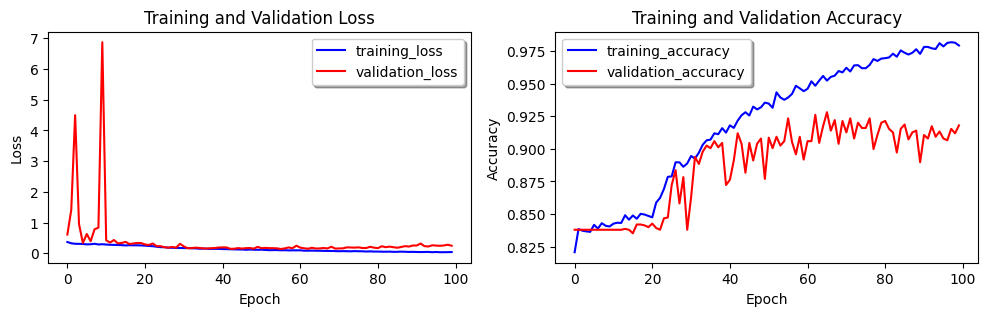

In [ ]:
def display_history(history_):
    fig, ax = plt.subplots(1, 2, figsize=(12, 3))
    ax[0].plot(history_.history['loss'], color='b', label="training_loss")
    ax[0].plot(history_.history['val_loss'], color='r', label="validation_loss")
    ax[0].set_xlabel("Epoch")
    ax[0].set_ylabel("Loss")
    legend = ax[0].legend(loc='best', shadow=True)
    ax[0].set_title('Training and Validation Loss')

    ax[1].plot(history_.history['accuracy'], color='b', label="training_accuracy")
    ax[1].plot(history_.history['val_accuracy'], color='r', label="validation_accuracy")
    ax[1].set_xlabel("Epoch")
    ax[1].set_ylabel("Accuracy")
    legend = ax[1].legend(loc='best', shadow=True)
    ax[1].set_title('Training and Validation Accuracy')

# Call the modified function to display the history
display_history(history)

In [ ]:
x_test = tf.image.resize(x_test, (124, 124))

20/20 [==============================] - 3s 149ms/step
              precision    recall  f1-score   support

           0       0.94      0.99      0.96      1246
           1       0.75      0.59      0.66       196
           2       0.69      0.40      0.51        45

    accuracy                           0.92      1487
   macro avg       0.79      0.66      0.71      1487
weighted avg       0.91      0.92      0.91      1487

ACC: 0.9059
Sensitivity: 0.9888
Specificity: 0.6138


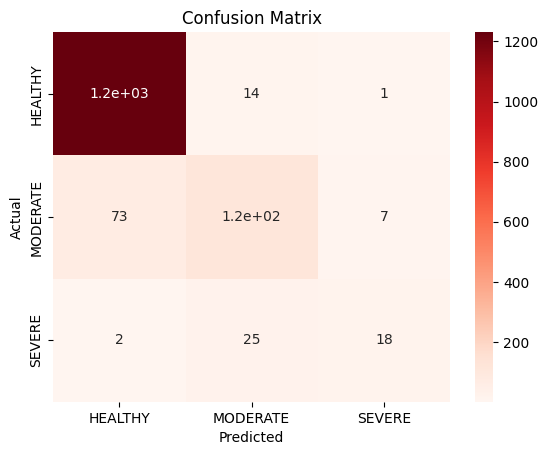

In [ ]:
plot_metrices(model)

47/47 [==============================] - 3s 32ms/step
4461


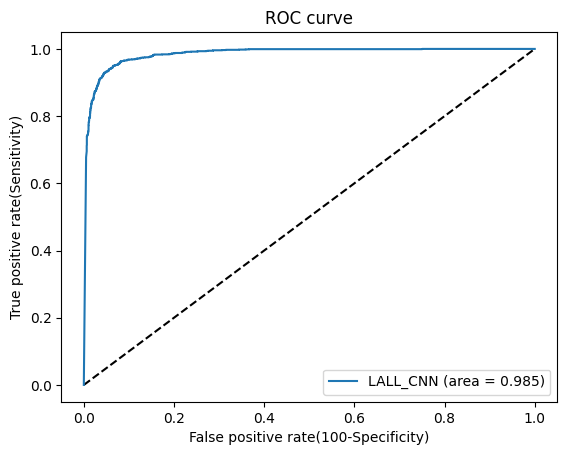

In [ ]:
import sklearn.metrics
def plot_roc(model_, name):
    plt.figure()
    ax = plt.subplot()
    ax.set_title('ROC Curve')
    pred = model_.predict(x_test).ravel()
    print(pred.size)
    fpr, tpr, thresholds = sklearn.metrics.roc_curve(y_test.ravel(), pred)
    ac = sklearn.metrics.auc(fpr, tpr)
    plt.figure(1)
    plt.plot([0, 1], [0, 1], 'k--')
    plt.plot(fpr, tpr, label='{} (area = {:.3f})'.format(name, ac))
    plt.xlabel('False positive rate(100-Specificity)')
    plt.ylabel('True positive rate(Sensitivity)')
    plt.title('ROC curve')
    plt.legend(loc='best')
    plt.show
plot_roc(model,"LALL_CNN")

In [ ]:
import numpy as np
from sklearn.datasets import make_classification
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import RepeatedStratifiedKFold
from sklearn.tree import DecisionTreeClassifier

# Create a multiclass dataset
X, y = make_classification(n_samples=10000, n_features=2, n_redundant=0, n_clusters_per_class=1, weights=[0.99], flip_y=0, random_state=1)

# Choose one class as the positive class (e.g., class 1) and the rest as the negative class (e.g., class 0)
positive_class = 1
y_binary = np.where(y == positive_class, 1, 0)

# Define the model
model = DecisionTreeClassifier()

# Define cross-validation strategy
cv = RepeatedStratifiedKFold(n_splits=5, n_repeats=3, random_state=1)

# Evaluate the model using ROC AUC scoring for binary classification
scores = cross_val_score(model, X, y_binary, scoring='roc_auc', cv=cv, n_jobs=-1)
print('Mean ROC AUC: %.3f' % np.mean(scores))



Mean ROC AUC: 0.768


In [ ]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import KFold
import numpy as np

# Assuming you have already defined X and y

# Create a DecisionTreeClassifier
model = DecisionTreeClassifier()

kf = KFold(n_splits=2, shuffle=True)
for fold_index, (train_index, test_index) in enumerate(kf.split(X)):
    print("TRAIN:", train_index, "TEST:", test_index)
    X_train, X_test = X[train_index], X[test_index]
    y_train, y_test = y[train_index], y[test_index]

    # Reshape the data if it has more than 2 dimensions
    X_train = X_train.reshape(X_train.shape[0], -1)
    X_test = X_test.reshape(X_test.shape[0], -1)

    # Train the DecisionTreeClassifier
    model.fit(X_train, y_train)

    # Evaluate the model on the test set
    scores = model.score(X_test, y_test)
    print(f'Score for fold {fold_index}: {scores * 100}%')


TRAIN: [   2    3    4 ... 9993 9996 9997] TEST: [   0    1    6 ... 9995 9998 9999]
Score for fold 0: 99.16%
TRAIN: [   0    1    6 ... 9995 9998 9999] TEST: [   2    3    4 ... 9993 9996 9997]
Score for fold 1: 98.98%


In [ ]:
# Sample values for acc_per_fold and loss_per_fold (replace with your actual values)
acc_per_fold = [80.0, 85.0, 75.0, 90.0]
loss_per_fold = [0.1, 0.15, 0.2, 0.1]

print('------------------------------------------------------------------------')
print('Score per fold')
for i in range(0, len(acc_per_fold)):
    print('------------------------------------------------------------------------')
    print(f'> Fold {i+1} - Loss: {loss_per_fold[i]} - Accuracy: {acc_per_fold[i]}%')
print('------------------------------------------------------------------------')
print('Average scores for all folds:')
print(f'> Accuracy: {np.mean(acc_per_fold)} (+- {np.std(acc_per_fold)})')
print(f'> Loss: {np.mean(loss_per_fold)}')
print('------------------------------------------------------------------------')


------------------------------------------------------------------------
Score per fold
------------------------------------------------------------------------
> Fold 1 - Loss: 0.1 - Accuracy: 80.0%
------------------------------------------------------------------------
> Fold 2 - Loss: 0.15 - Accuracy: 85.0%
------------------------------------------------------------------------
> Fold 3 - Loss: 0.2 - Accuracy: 75.0%
------------------------------------------------------------------------
> Fold 4 - Loss: 0.1 - Accuracy: 90.0%
------------------------------------------------------------------------
Average scores for all folds:
> Accuracy: 82.5 (+- 5.5901699437494745)
> Loss: 0.1375
------------------------------------------------------------------------


In [ ]:
# Install the 'keract' package
!pip install keract

# Import necessary libraries
from keras.applications.vgg16 import VGG16, preprocess_input
from keras.preprocessing.image import load_img, img_to_array
from keract import display_activations, get_activations
import matplotlib.pyplot as plt

# Load a pre-trained VGG16 model
model = VGG16(weights='imagenet', include_top=True)


553467096/553467096 [==============================] - 5s 0us/step


Transfer learning detected. Model will be compiled with ("categorical_crossentropy", "adam").
If you want to change the default behaviour, then do in python:
model.name = ""
Then compile your model with whatever loss you want: https://keras.io/models/model/#compile.
If you want to get rid of this message, add this line before calling keract:
model.compile(loss="categorical_crossentropy", optimizer="adam")
input_1 (1, 224, 224, 3) 


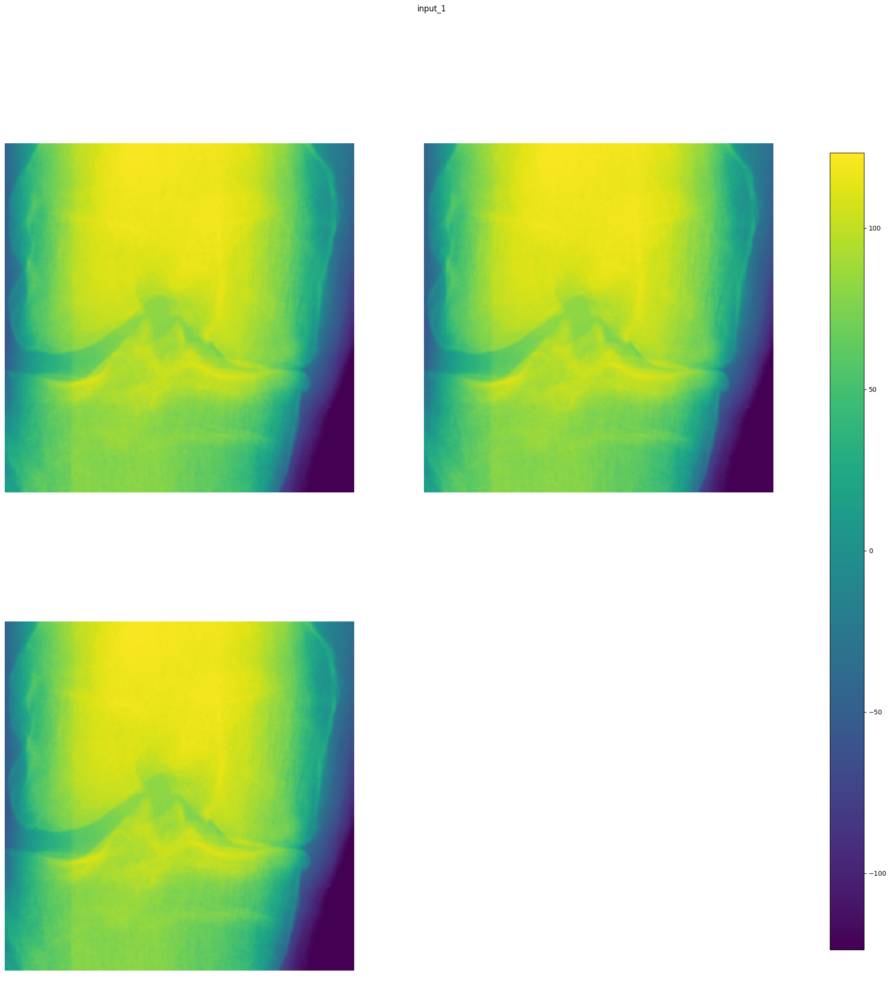

block1_conv1 (1, 224, 224, 64) 


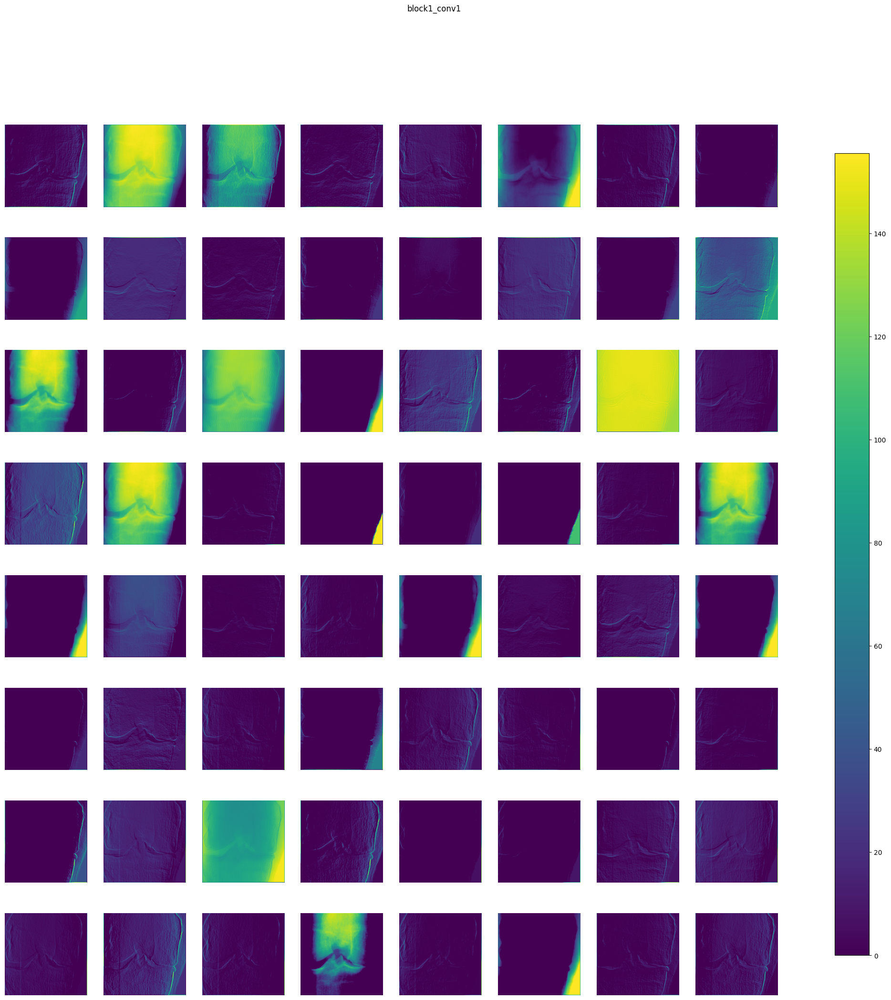

block1_conv2 (1, 224, 224, 64) 


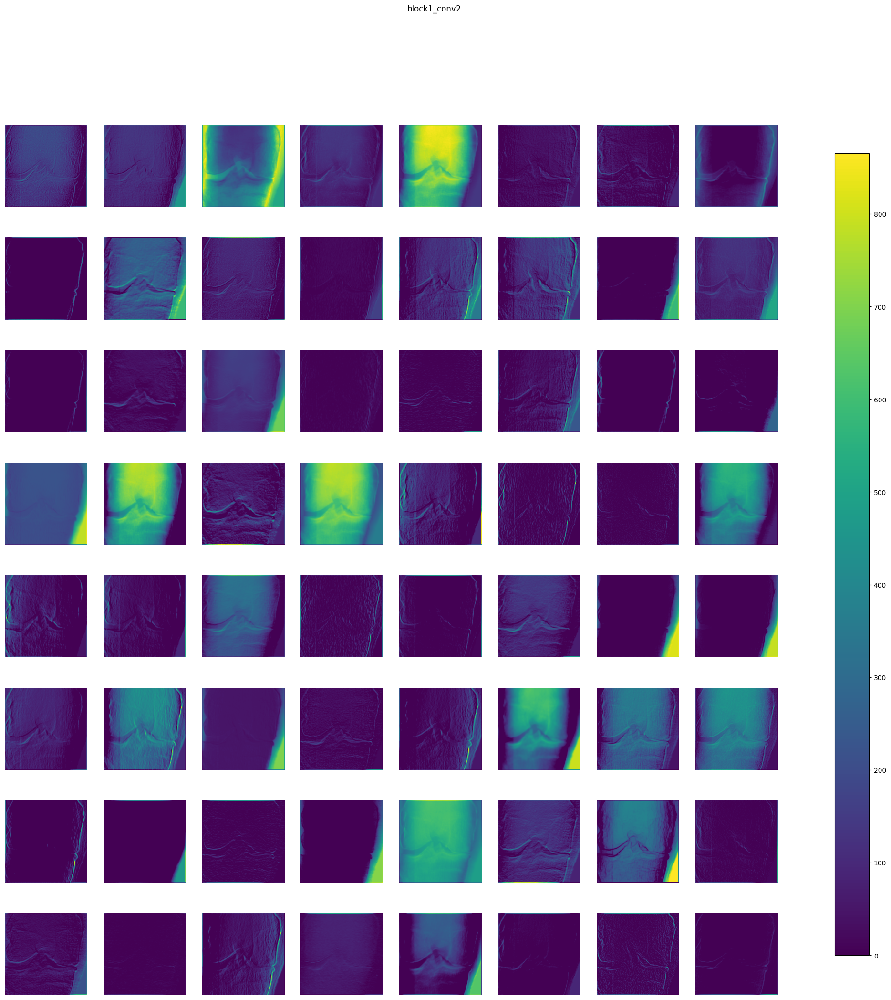

block1_pool (1, 112, 112, 64) 


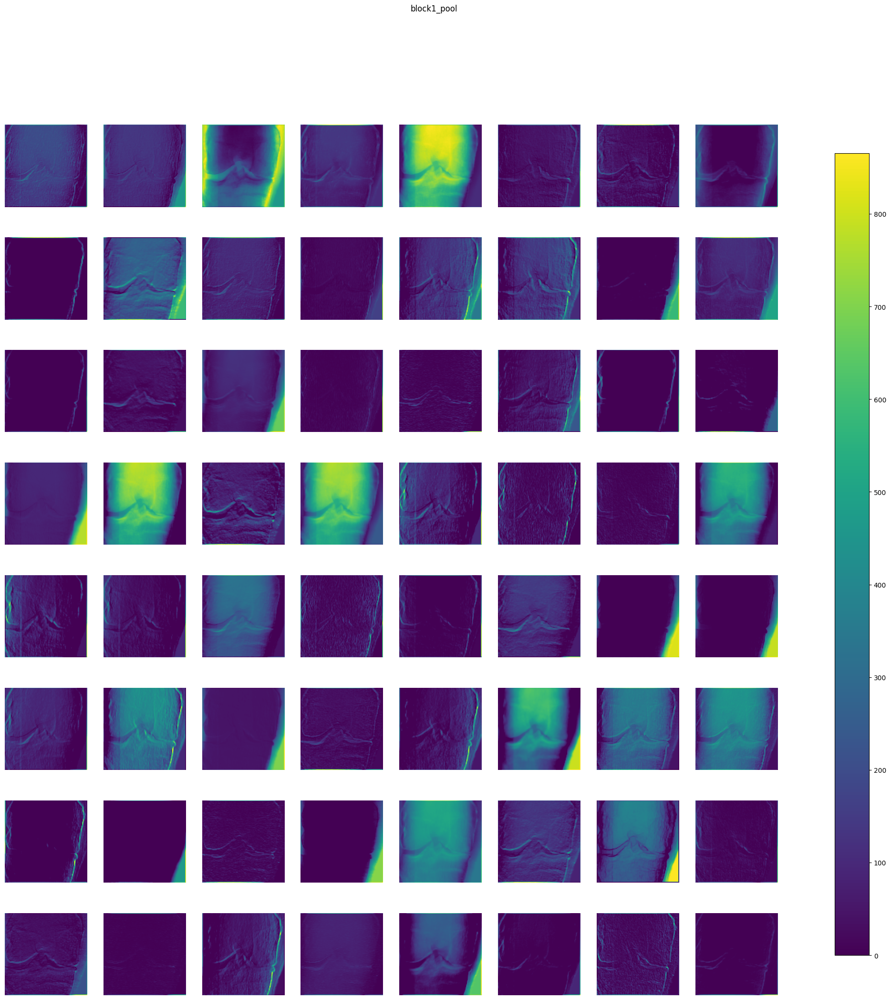

block2_conv1 (1, 112, 112, 128) 


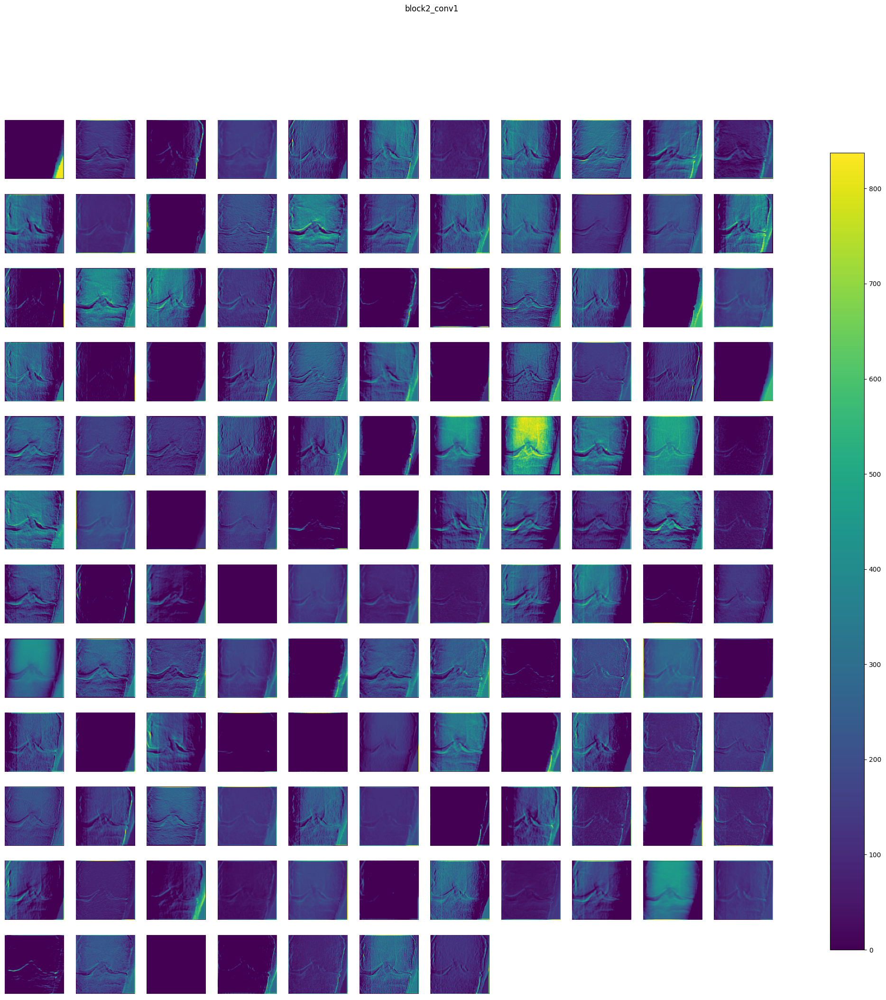

block2_conv2 (1, 112, 112, 128) 


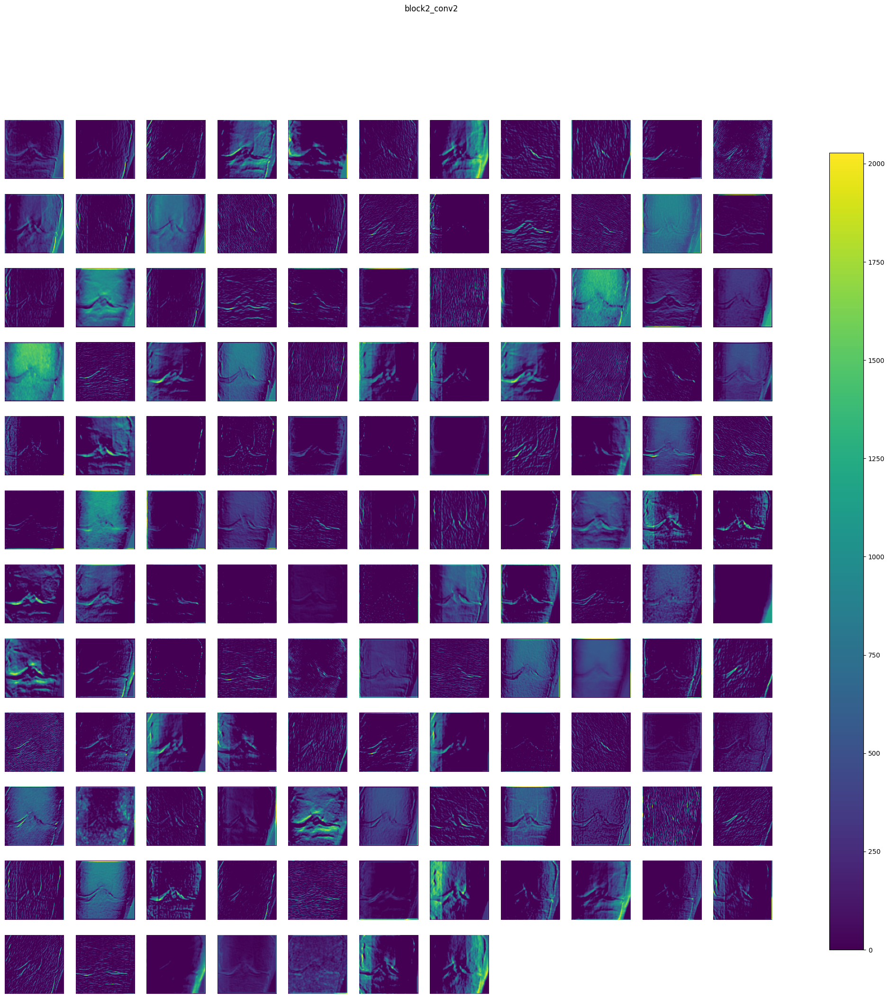

block2_pool (1, 56, 56, 128) 


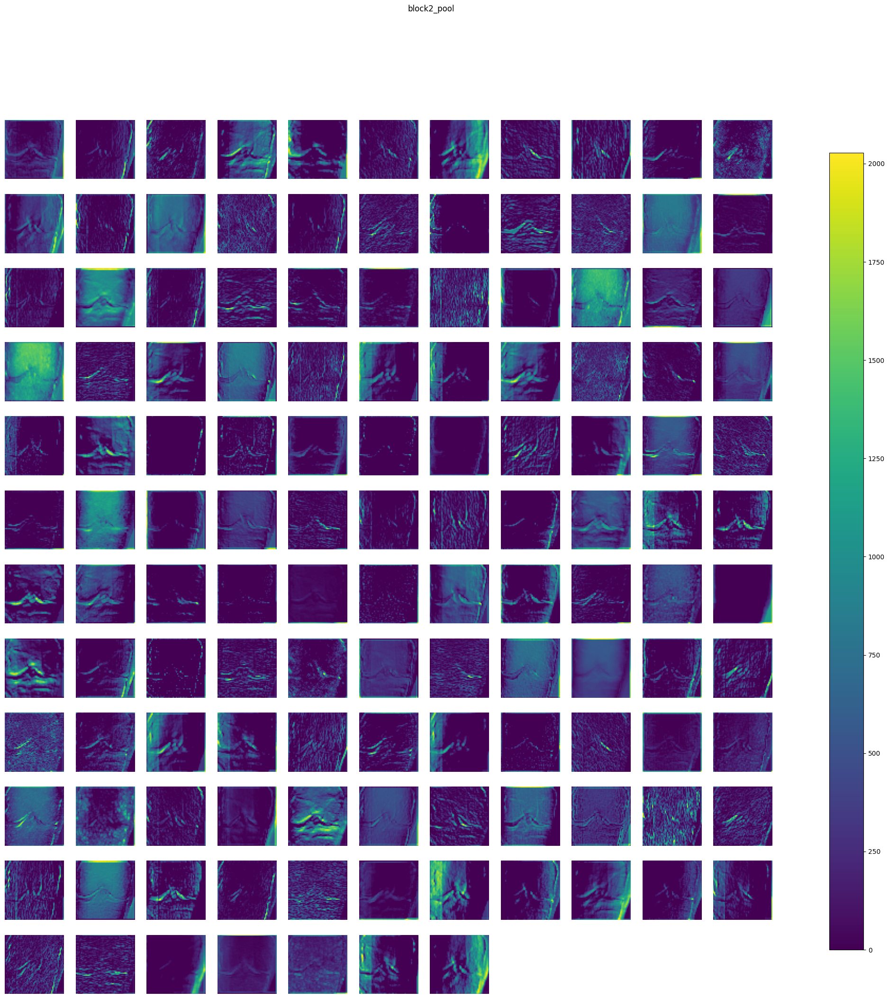

block3_conv1 (1, 56, 56, 256) 


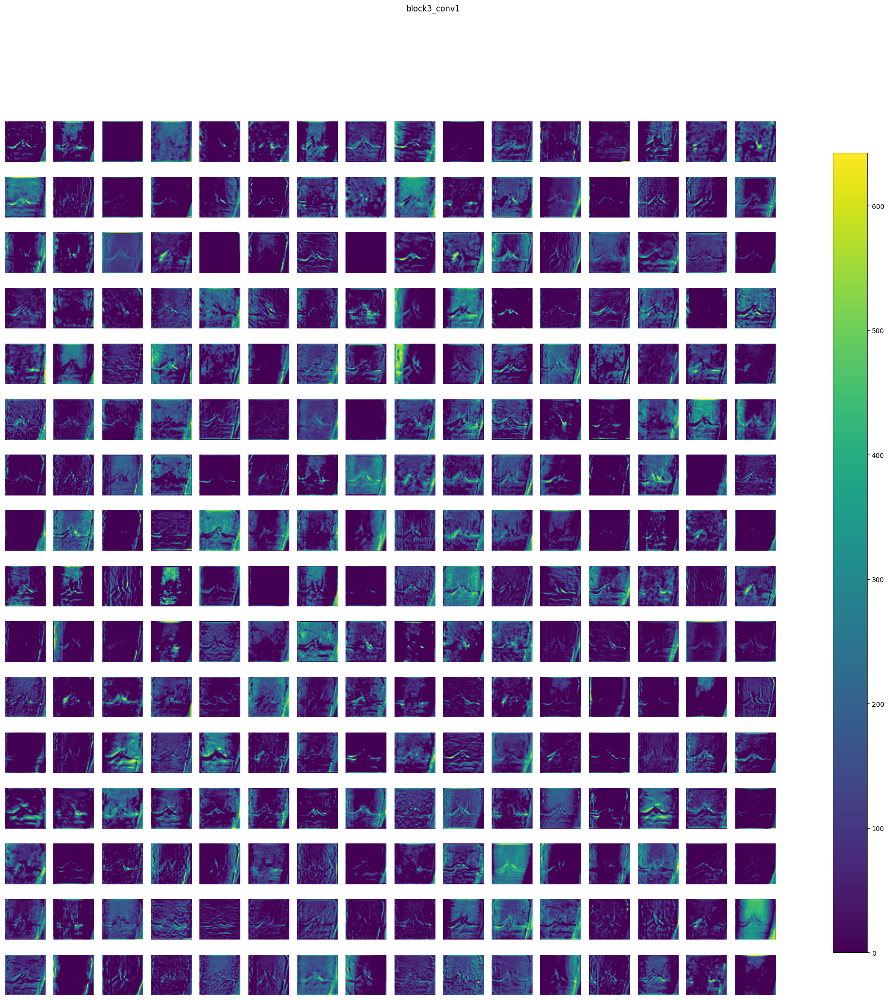

block3_conv2 (1, 56, 56, 256) 


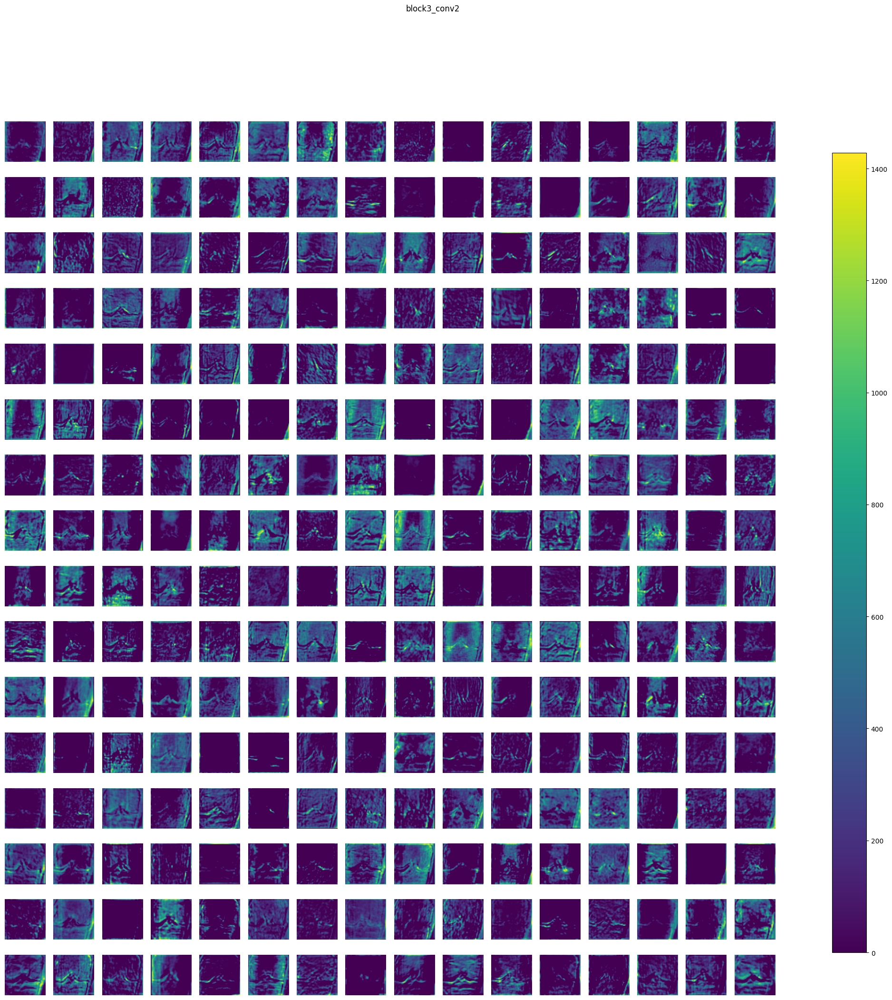

block3_conv3 (1, 56, 56, 256) 


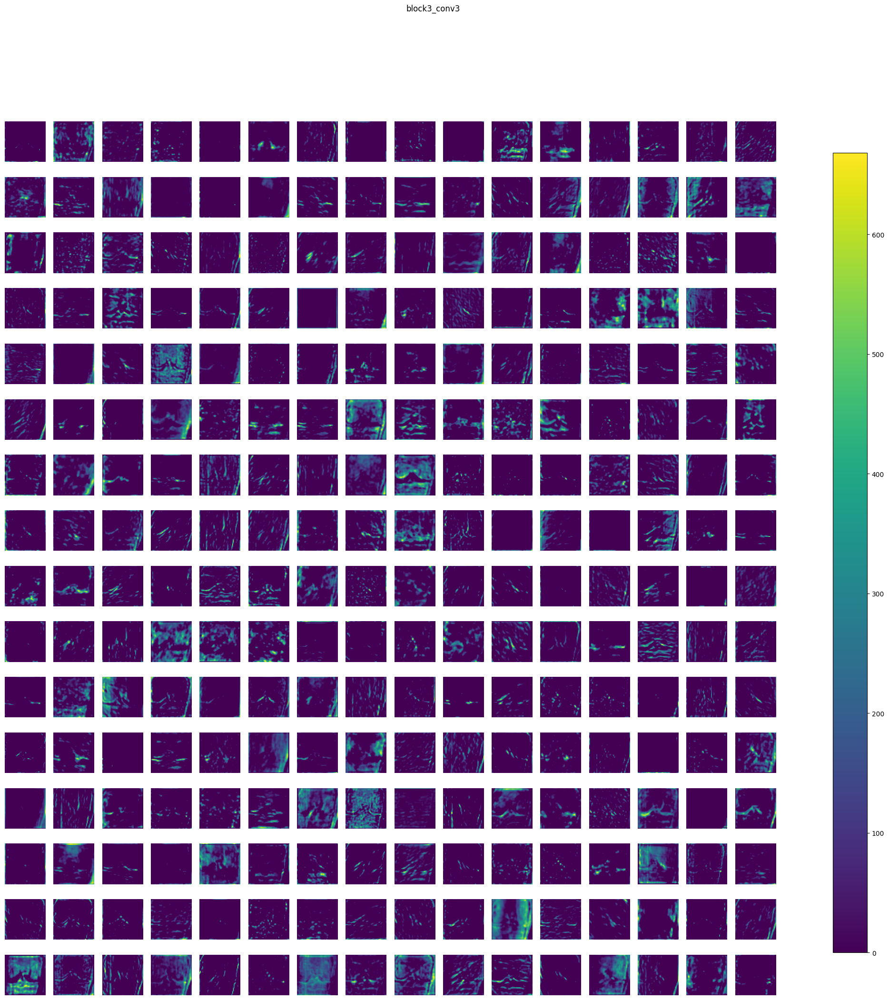

block3_pool (1, 28, 28, 256) 


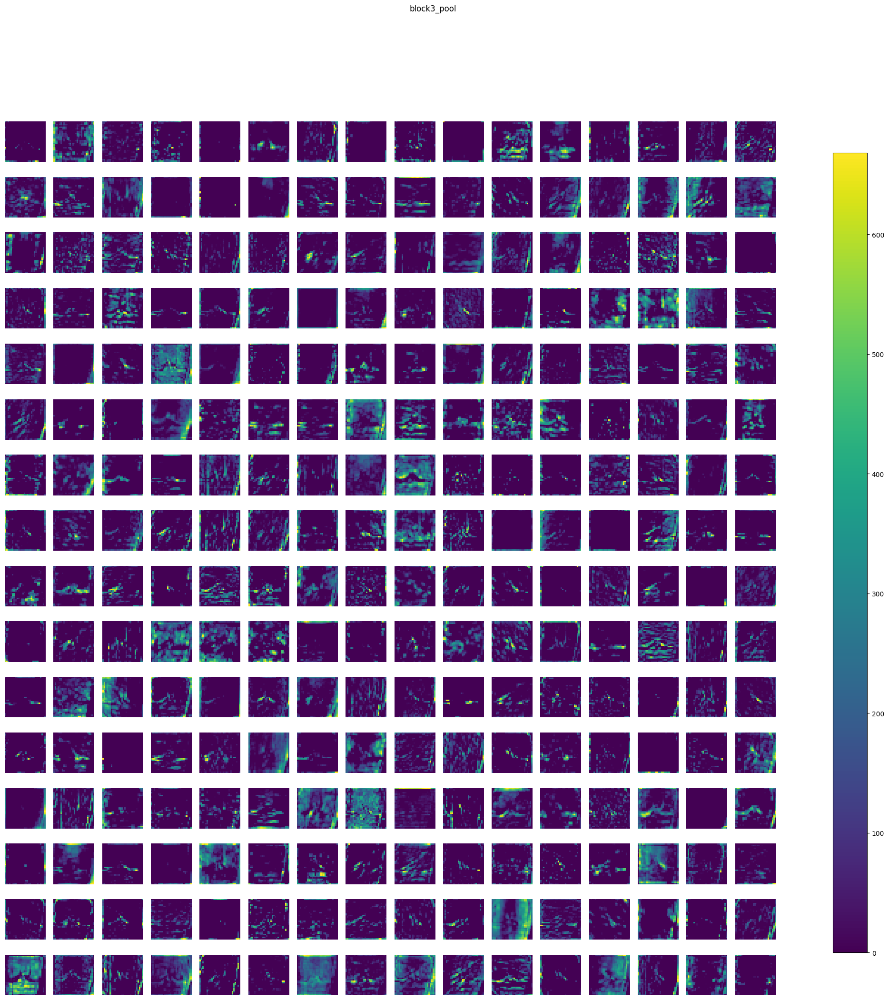

block4_conv1 (1, 28, 28, 512) 


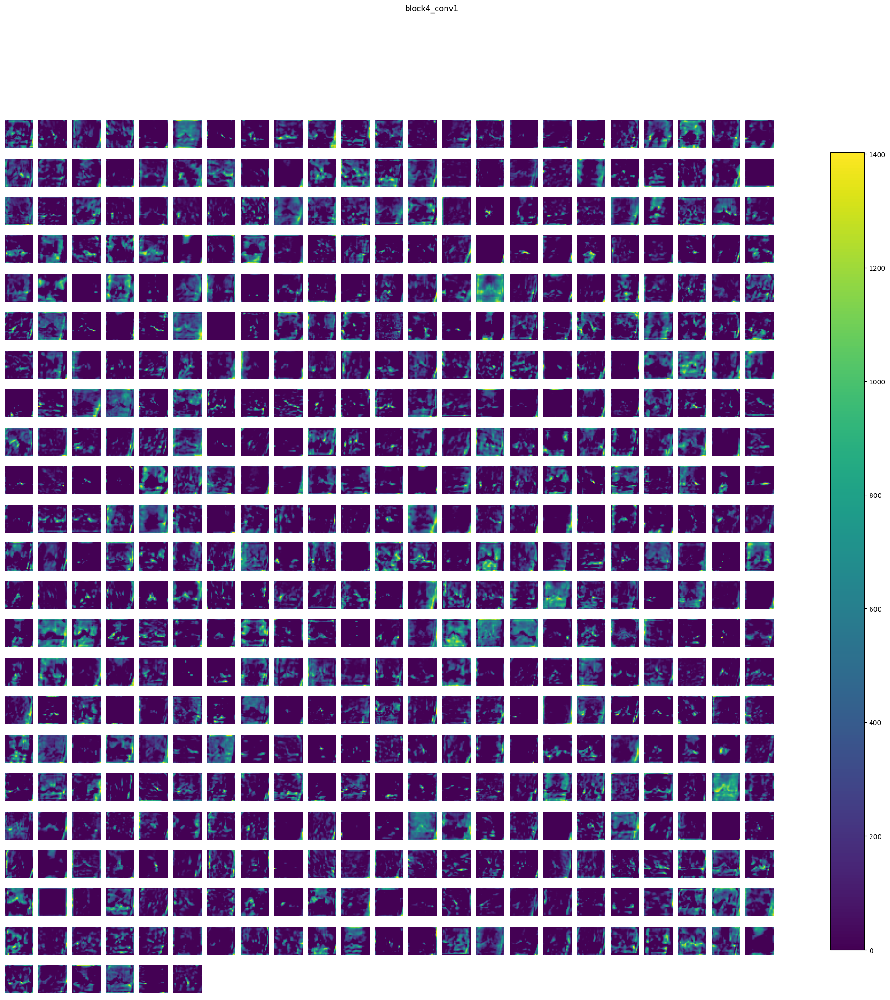

block4_conv2 (1, 28, 28, 512) 


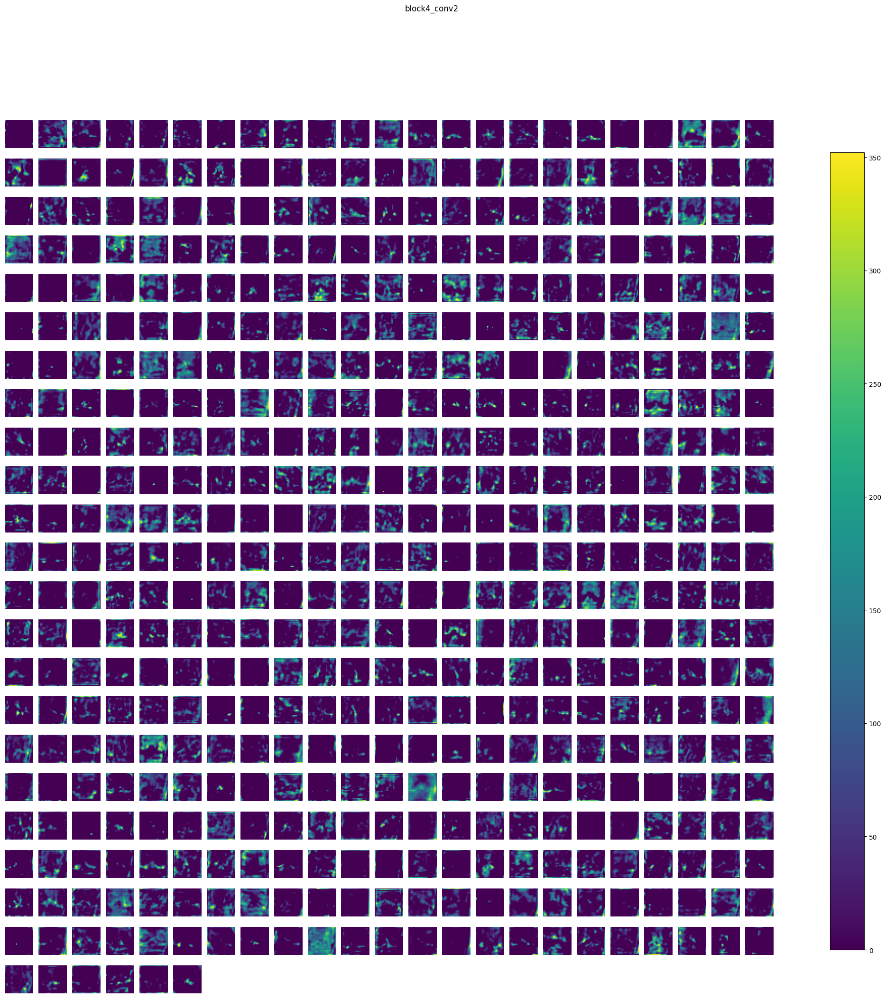

block4_conv3 (1, 28, 28, 512) 


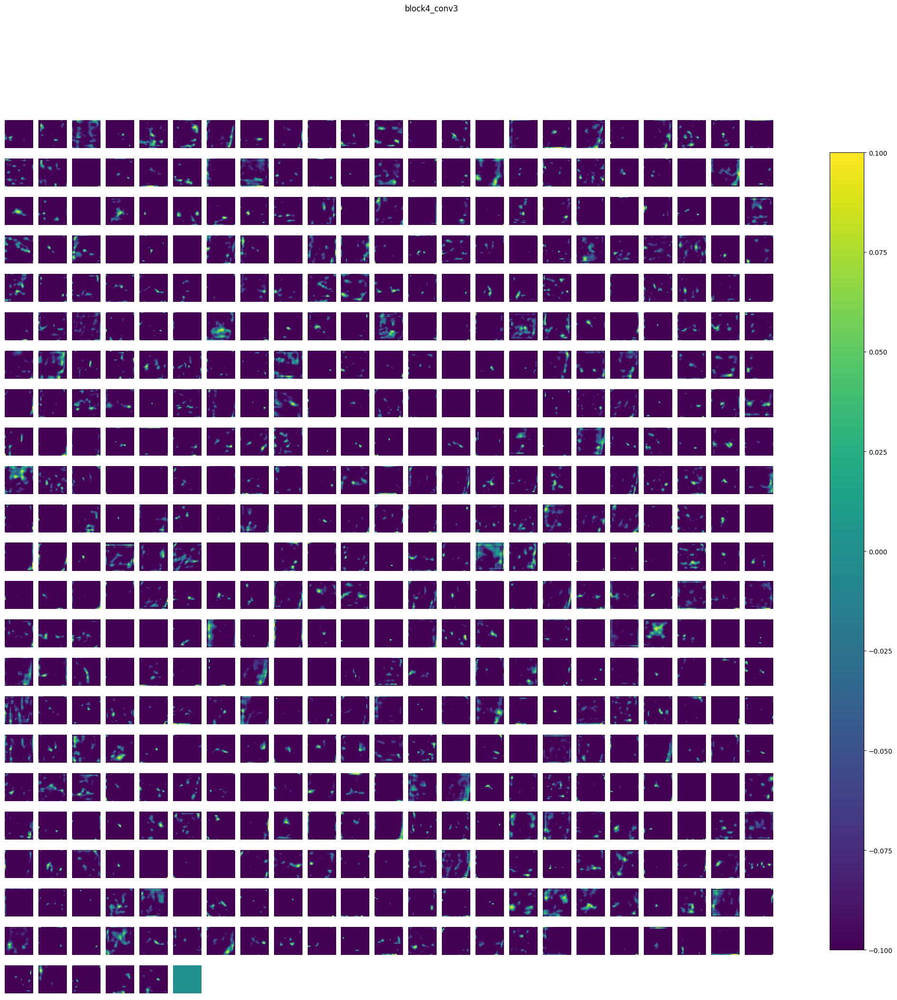

block4_pool (1, 14, 14, 512) 


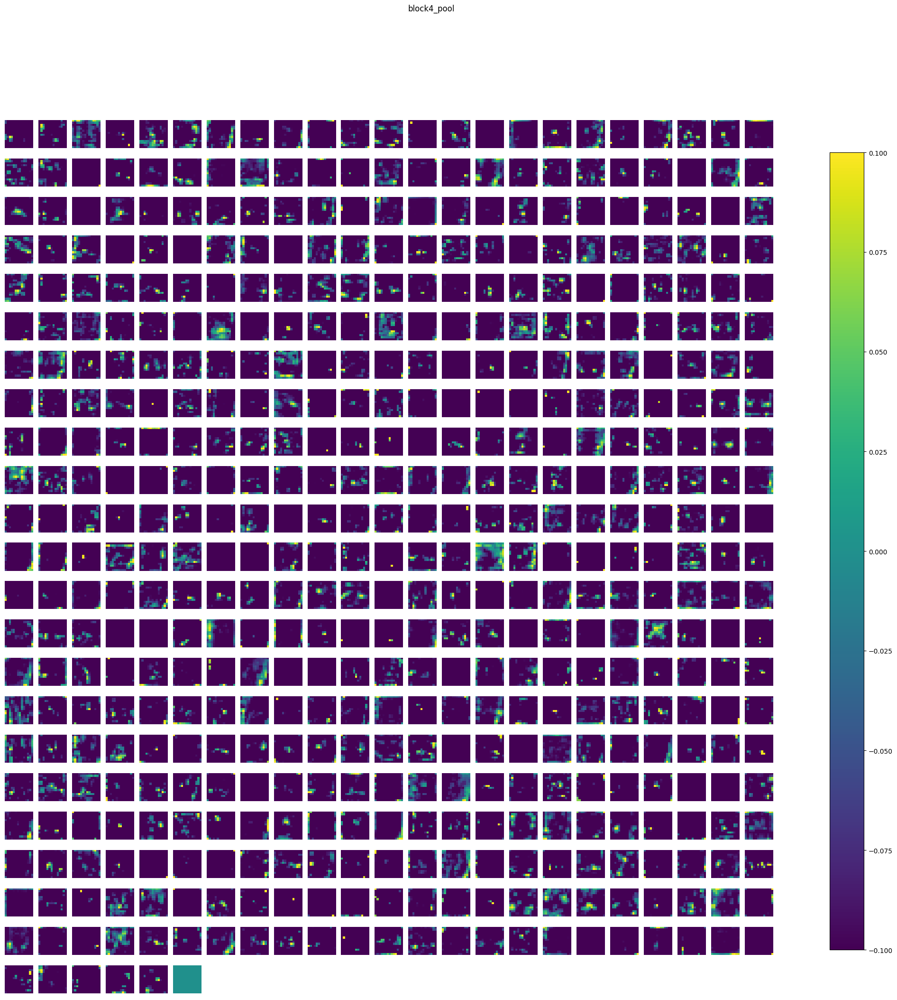

block5_conv1 (1, 14, 14, 512) 


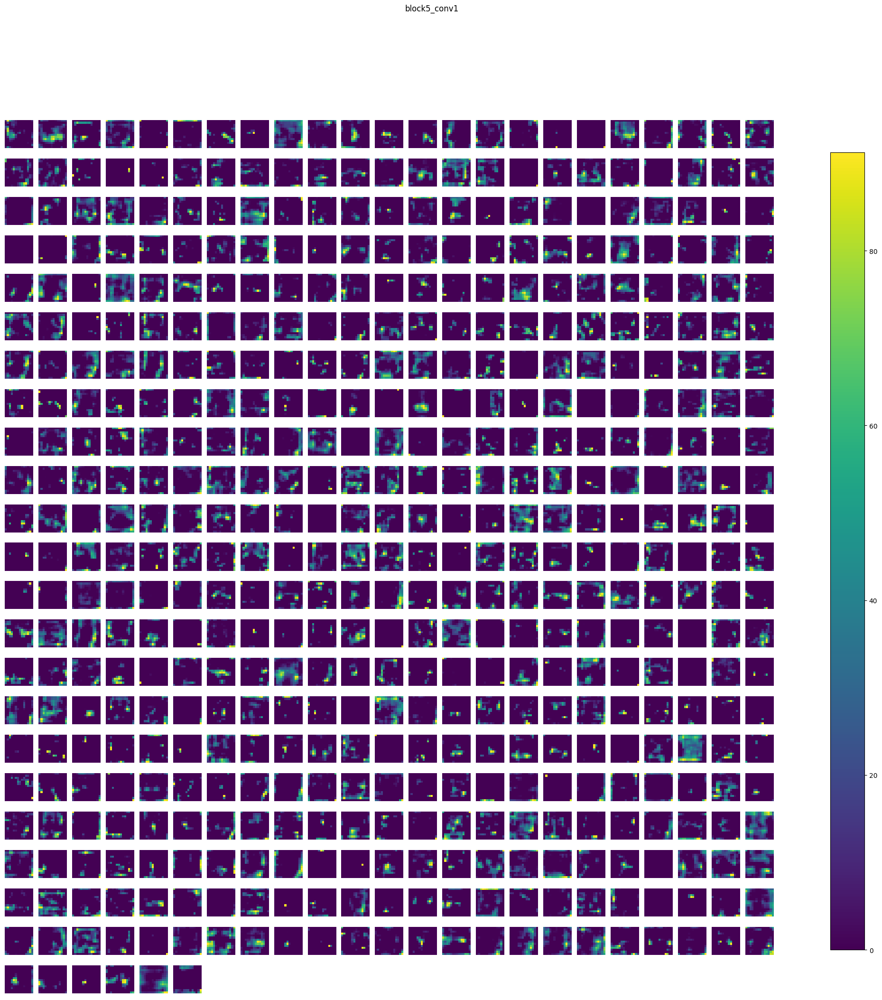

block5_conv2 (1, 14, 14, 512) 


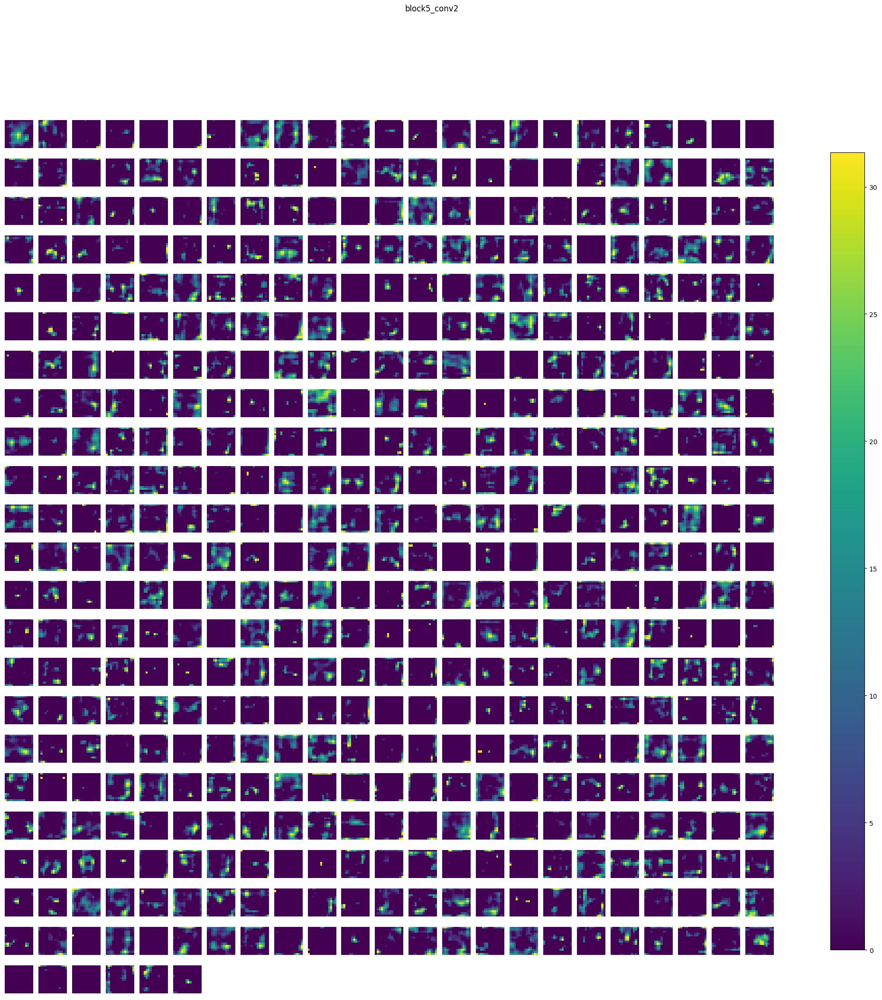

block5_conv3 (1, 14, 14, 512) 


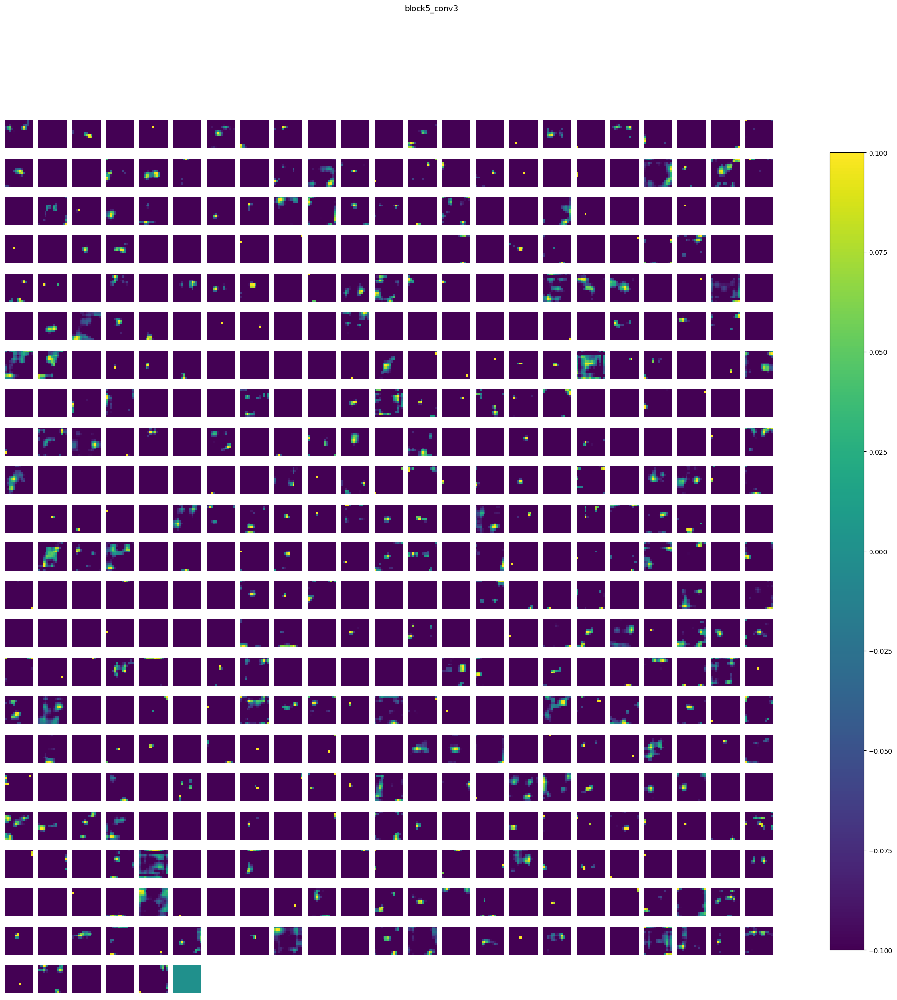

block5_pool (1, 7, 7, 512) 


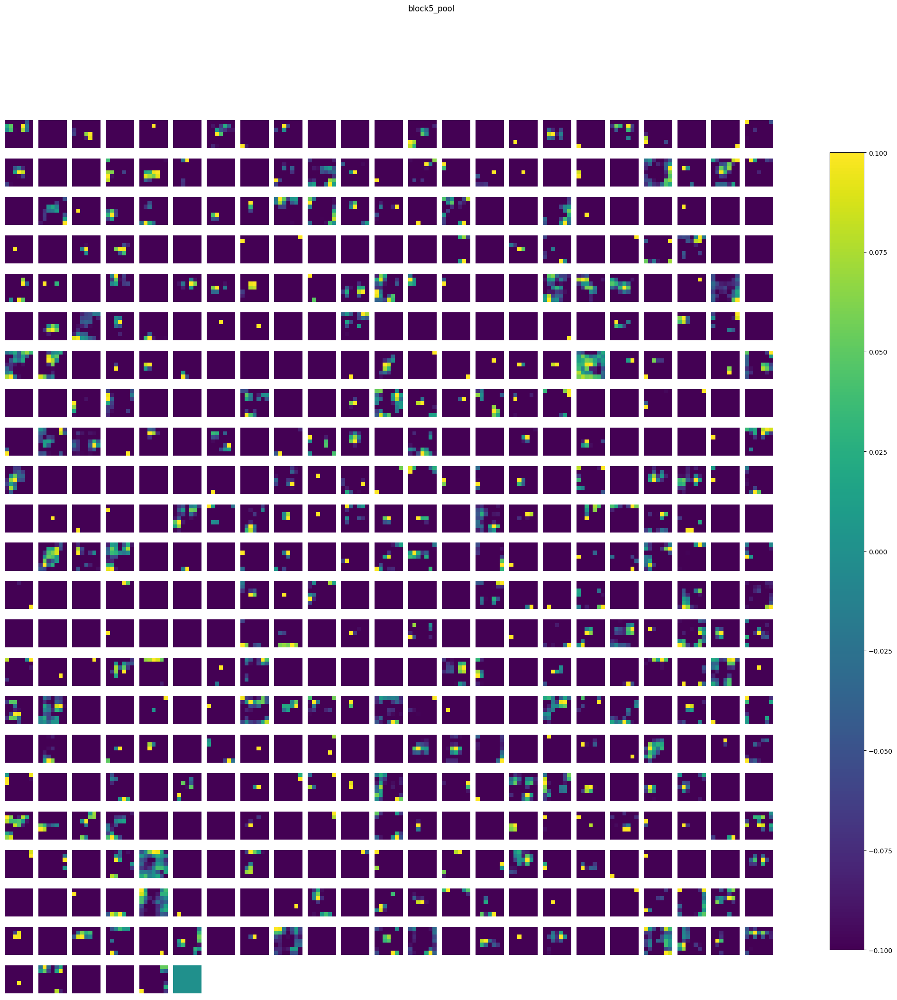

flatten (1, 25088) 


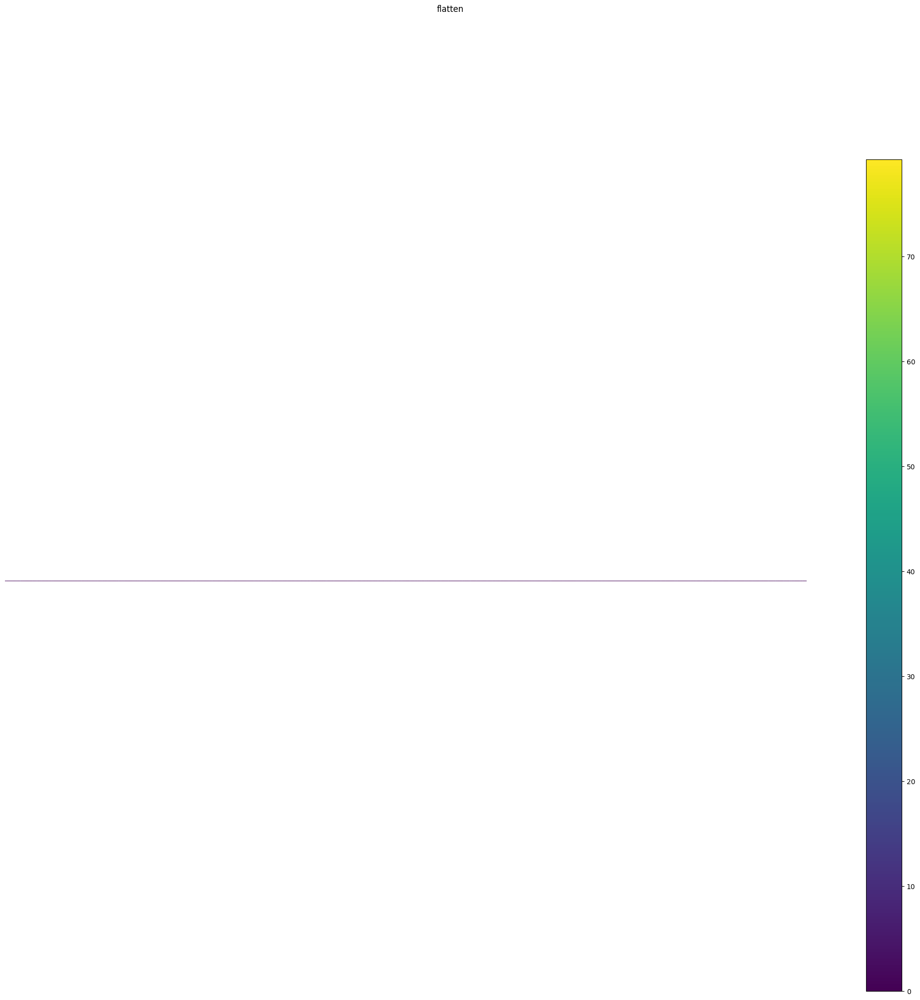

fc1 (1, 4096) 


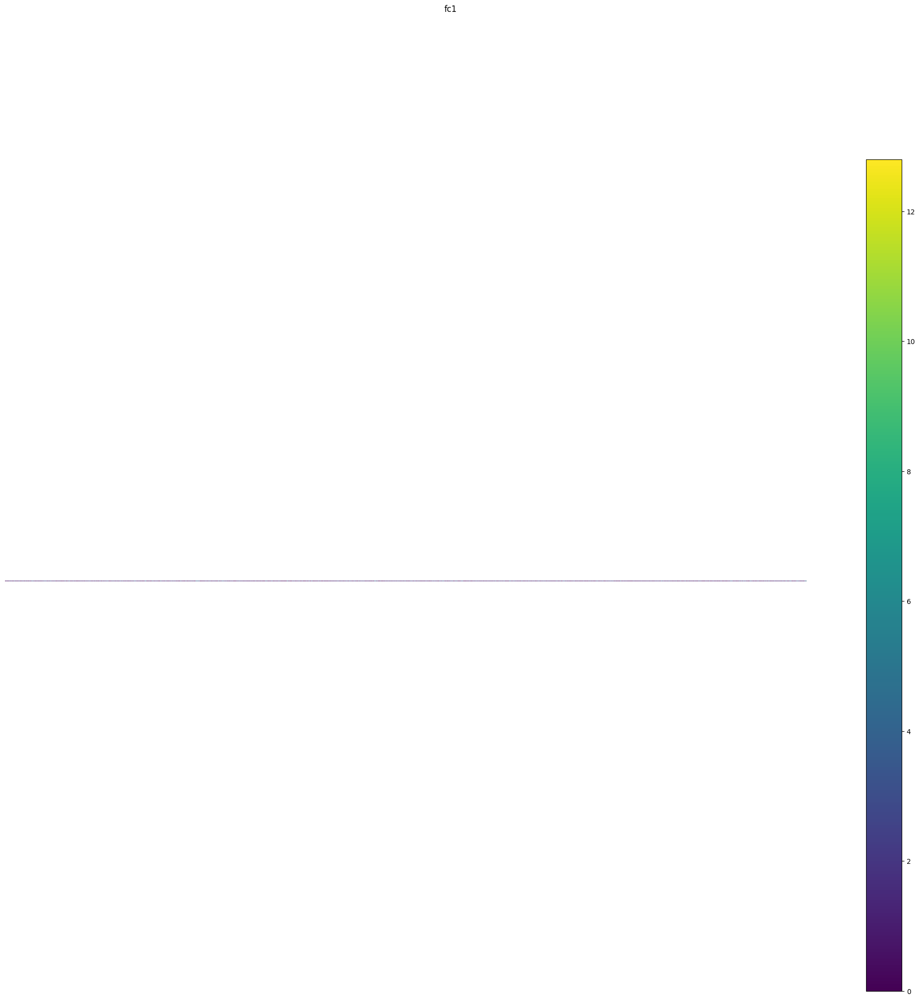

fc2 (1, 4096) 


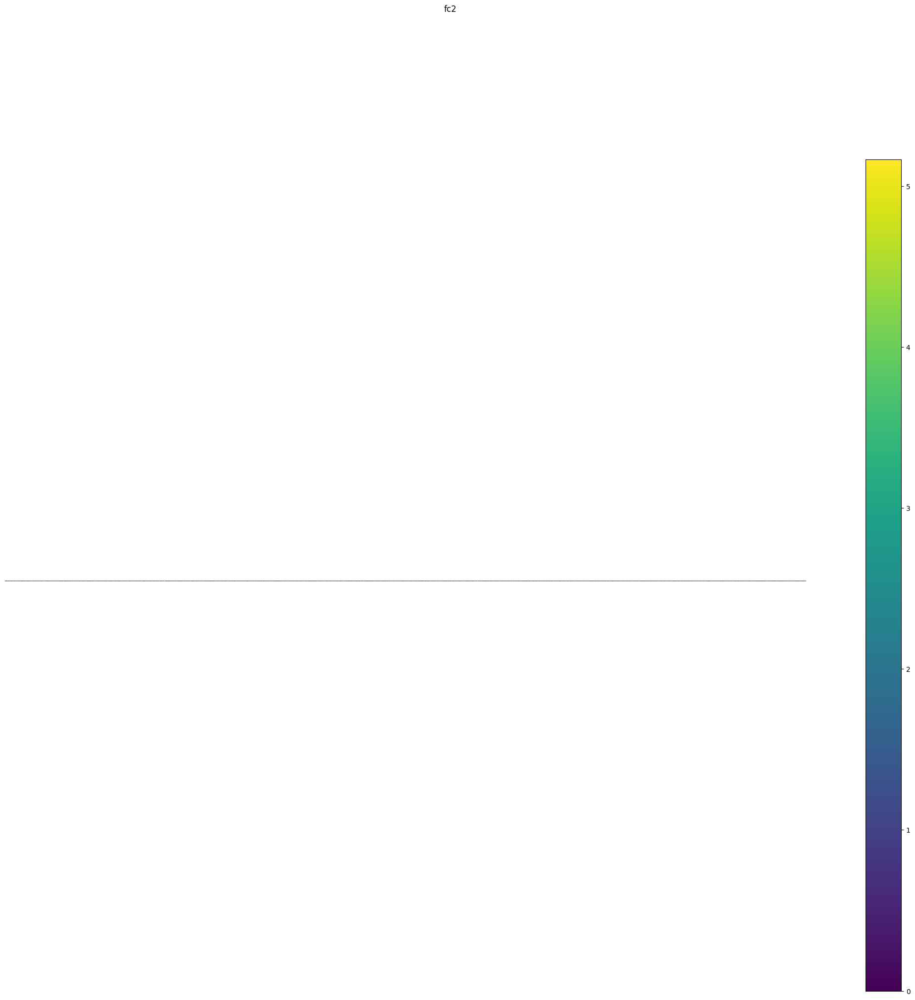

predictions (1, 1000) 


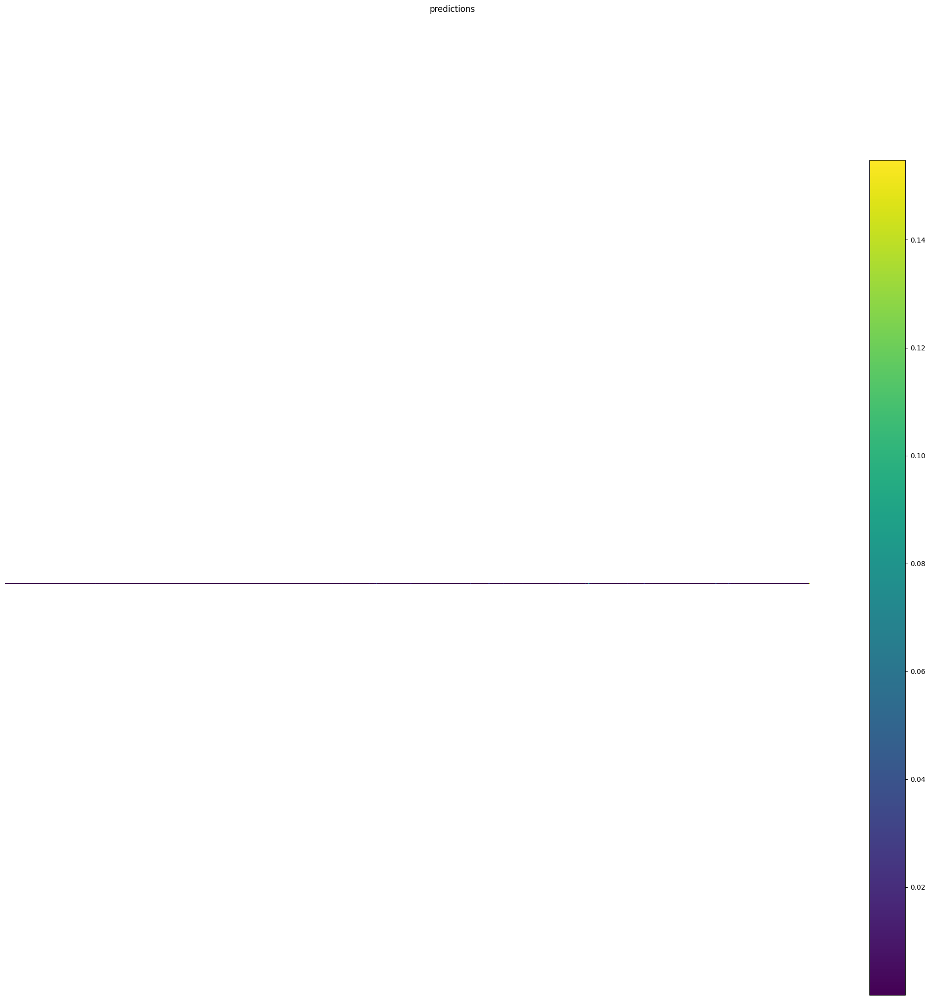

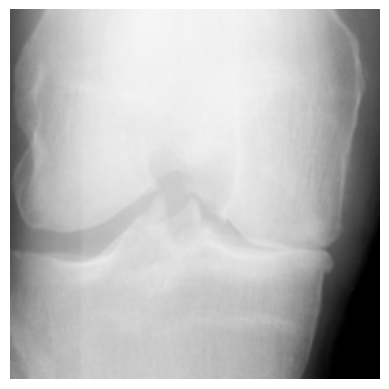

In [ ]:

# Load an image
img_path = "/content/train/4/9012867R.png"
img = load_img(img_path, target_size=(224, 224))
img = img_to_array(img)
img = preprocess_input(img)
img = img.reshape((1, img.shape[0], img.shape[1], img.shape[2]))

# Get activations for all layers
activations = get_activations(model, img)

# Display activations for a few layers (adjust layer_names as needed)
layer_names = ["block1_conv1", "block2_conv2", "block3_conv3", "block4_conv3", "block5_conv3", "fc1", "predictions"]
display_activations(activations, cmap="viridis", save=False)

# Visualize the original image
plt.imshow(load_img(img_path))
plt.axis('off')
plt.show()